<a target="_blank" href="https://colab.research.google.com/github/pr4deepr/cellpose-colab/blob/main/Cellpose_cell_segmentation_2D_prediction_only.ipynb">
  <img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/>
</a>

#**Cellpose Prediction for 2D v0.5**
A generalist algorithm for cell and nucleus segmentation.

***Cellpose code: Carsen Stringer & Marius Pachitariu***

[Link to Paper](https://www.nature.com/articles/s41592-020-01018-x)

[Link to Video talk](https://t.co/JChCsTD0SK?amp=1)

Github Repo: https://github.com/MouseLand/cellpose

The notebook is for processing **2D** images using the Cellpose package on Google Colab using the GPU. It processes images within the folder specified by the user. It will generate a folder called Masks which will contain the label images generated by Cellpose.

The user can fine-tune and preview the parameters on one image before running it on all images within the folder. The user-specified channel will be used on all images for segmentation.

This notebook was inspired by the [ZeroCostDL4Mic notebook series](https://github.com/HenriquesLab/ZeroCostDL4Mic/wiki). It was also adapted from colab notebook by Matteo Carandini hosted on the Cellpose github page.

I have only tested it on jpg and tiff files. Feel free to email me if you have any questions.

**This notebook uses cellpose v2.3.2.**

v0.5 update:

* 2024/04/09 Constrained cellpose version to be 2.3.2 to maintain compatibility.


v0.4 update:

* Fixed bug where new models could not be used for prediction


v0.3 update:

* Updated for Cellpose 2.0
* New models incorporated: https://cellpose.readthedocs.io/en/latest/models.html
* Parameters used in cellpose will be saved as a txt file (Thanks for suggestion Kota Miura)



***Author of this notebook: Pradeep Rajasekhar***

***Walter and Eliza Hall Institute of Medical Research, Melbourne, Australia***

rajasekhar.p@wehi.edu.au

#**Configuration**

### Make sure you have GPU access enabled by going to Runtime -> Change Runtime Type -> Hardware accelerator and selecting GPU

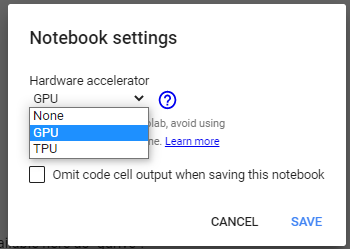

In [ ]:
#@markdown ##Step 1: Run this cell to connect your Google Drive to colab

#@markdown * Click on the URL.

#@markdown * Sign in your Google Account.

#@markdown You will either have to:
#@markdown * copy the authorisation code and enter it into box below OR

#@markdown * in the new google colab, you can just click "Allow" and it should connect.

#@markdown * Click on "Folder" icon on the Left, press the refresh button. Your Google Drive folder should now be available here as "gdrive".

# mount user's Google Drive to Google Colab.
from google.colab import drive
drive.mount('/content/gdrive')

###**How to get google drive path to your images**

The above step allows this colab notebook to access your images from google drive. Now, you need the path of your folder containing the images. On the left of your notebook you will see a file icon:

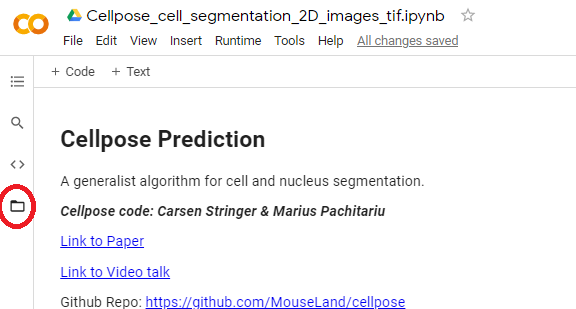

Click on the icon and it will give you:

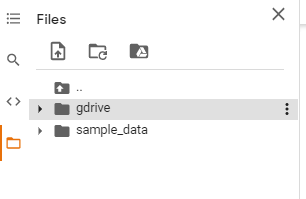

Your Google drive is under "gdrive". Click on the triangle icon on left of gdrive and it will be a dropdown view of your whole drive. Navigate to the folder containing your images. Once you are there, click on the three dots on the right of the folder and select "Copy Path"

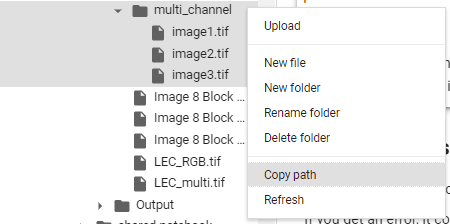

Copy and paste this path under the **Input_Directory** location below



---


# **Setup Cellpose**



Install GPU version of Cellpose and configure dependencies


In [72]:
#@markdown ##Step 2: Click Play to Install Cellpose
#@markdown **PLEASE WAIT FOR THIS CELL TO COMPLETE AND YOUR RUN TIME TO RESTART BEFORE CONTINUING TO STEP 3**
#@markdown * After cellpose installation, the runtime will restart a warning that it has **crashed**, which is fine. This is essential to configure the environment.


#@markdown * On occasion, you may not be able to see the folders on the left panel. Just refresh your browser webpage and it should appear.
#!pip install git+https://www.github.com/mouseland/cellpose.git #to install development version

!pip install "cellpose==2.3.2"
!pip install torch torchvision torchaudio
!pip install omnipose
!pip install torch torchvision torchaudio --index-url https://download.pytorch.org/whl/cu126


#Fix opencv error: ImportError: cannot import name '_registerMatType' from 'cv2.cv2'
#!pip install "opencv-python-headless<4.3"
#exit(0) #Restart Runtime to use newly installed numpy
#or may get the error: ValueError: numpy.ndarray size changed, may indicate binary incompatibility. Expected 88 from C header, got 80 from PyObject

#https://stackoverflow.com/questions/8924173/how-do-i-print-bold-text-in-python
BOLD = '\033[1m'
UNDERLINE = '\033[4m'
END = '\033[0m'



print("\n"+BOLD+UNDERLINE+"Restarting the RUNTIME. Wait till you see the green tick on the right top, next to RAM and Disk before proceeding."+END)


Looking in indexes: https://download.pytorch.org/whl/cu126

Restarting the RUNTIME. Wait till you see the green tick on the right top, next to RAM and Disk before proceeding.


In [74]:
#@markdown ##Step 3: Once **Step 2 is completed**, run this cell to configure Cellpose, dependencies and check GPU access
#@markdown

#@markdown *Models will be downloaded when running for the first time*
#disabled installation and import of mxnet as pytorch is the default neural net
import numpy as np
import time, os, sys, random
from urllib.parse import urlparse
import skimage.io
import matplotlib.pyplot as plt
import matplotlib as mpl
%matplotlib inline
mpl.rcParams['figure.dpi'] = 300

from urllib.parse import urlparse
import shutil

#from tifffile import imread, imsave


print ("Downloading Models")
from cellpose import models,core

model_list = models.MODEL_NAMES

#Enable Logging
from cellpose.io import logger_setup
logger_setup()

#https://stackoverflow.com/questions/8924173/how-do-i-print-bold-text-in-python
BOLD = '\033[1m'
UNDERLINE = '\033[4m'
END = '\033[0m'

#Check if colab notebook instance has GPU access
if core.use_gpu()==False:
  #Warnings from the ZeroCost StarDist notebook
  print(BOLD+UNDERLINE+'You do not have GPU access.'+END)
  print('Did you change your runtime ?')
  print('If the runtime setting is correct then Google did not allocate a GPU for your session')
  print('Expect slow performance. To access GPU try reconnecting later')
  use_GPU=False
else:
  print(BOLD+UNDERLINE+"You have access to the GPU."+END+"\nDetails are:")
  print("*************************************************")
  !nvidia-smi
  use_GPU=True

print("*************************************************")
print("Libraries imported and configured")


creating new log file
2024-10-23 20:27:19,629 [INFO] WRITING LOG OUTPUT TO C:\Users\xsy\.cellpose\run.log
2024-10-23 20:27:19,629 [INFO] 
cellpose version: 	2.3.2 
platform:       	win32 
python version: 	3.12.3 
torch version:  	2.4.1+cpu
2024-10-23 20:27:19,630 [INFO] TORCH CUDA version not installed/working.
You do not have GPU access.
Did you change your runtime ?
If the runtime setting is correct then Google did not allocate a GPU for your session
Expect slow performance. To access GPU try reconnecting later
*************************************************
Libraries imported and configured


In [12]:
#@markdown ###Step 4: Enter Directory path containing the images:
#@markdown ##### Existing Masks directory will be deleted. (Does not read images in subfolders)
import os
Input_Directory = "C:/Users/xsy/Desktop/Applied DS/downsampled_data" #@param {type:"string"}
input_dir = os.path.join(Input_Directory, "") #adds separator to the end regardless if path has it or not

#@markdown ###Optional: Enter image extension here to read only files/images of specified extension (.tif,.jpg..):
#@markdown ###### Leave empty if not specifying anything
image_format = "tiff" #@param {type:"string"}

##@markdown ###Tick if image is RGB:
#RGB= False #@param {type:"boolean"}
#rgb=RGB
save_dir = input_dir+"Masks/"
if not os.path.exists(save_dir):
  os.makedirs(save_dir)
else:
  print("Existing Mask Directory found. Deleting it.")
  shutil.rmtree(save_dir)

#@markdown ##### Save Directory will be created in the input path under Masks

##@markdown ###Advanced Parameters
#Use_Default_Advanced_Parameters = True #@param {type:"boolean"}


# r=root, d=directories, f = files
files=[]

for r, d, f in os.walk(input_dir):
    for fil in f:
      if (image_format):
        if fil.endswith(image_format):
          files.append(os.path.join(r, fil))
      else:
        files.append(os.path.join(r, fil))
    break #only read the root directory; can change this to include levels
if(len(files)==0):
  print("Number of images loaded: %d." %(len(files)))
  print("Cannot read image files. Check if folder has images")
else:
  print("Number of images loaded: %d." %(len(files)))




Number of images loaded: 2867.


No of images loaded are:  2867
Example Image:
r07c21f01_median_aggregated.tiff has 2 dimensions/s
One Channel


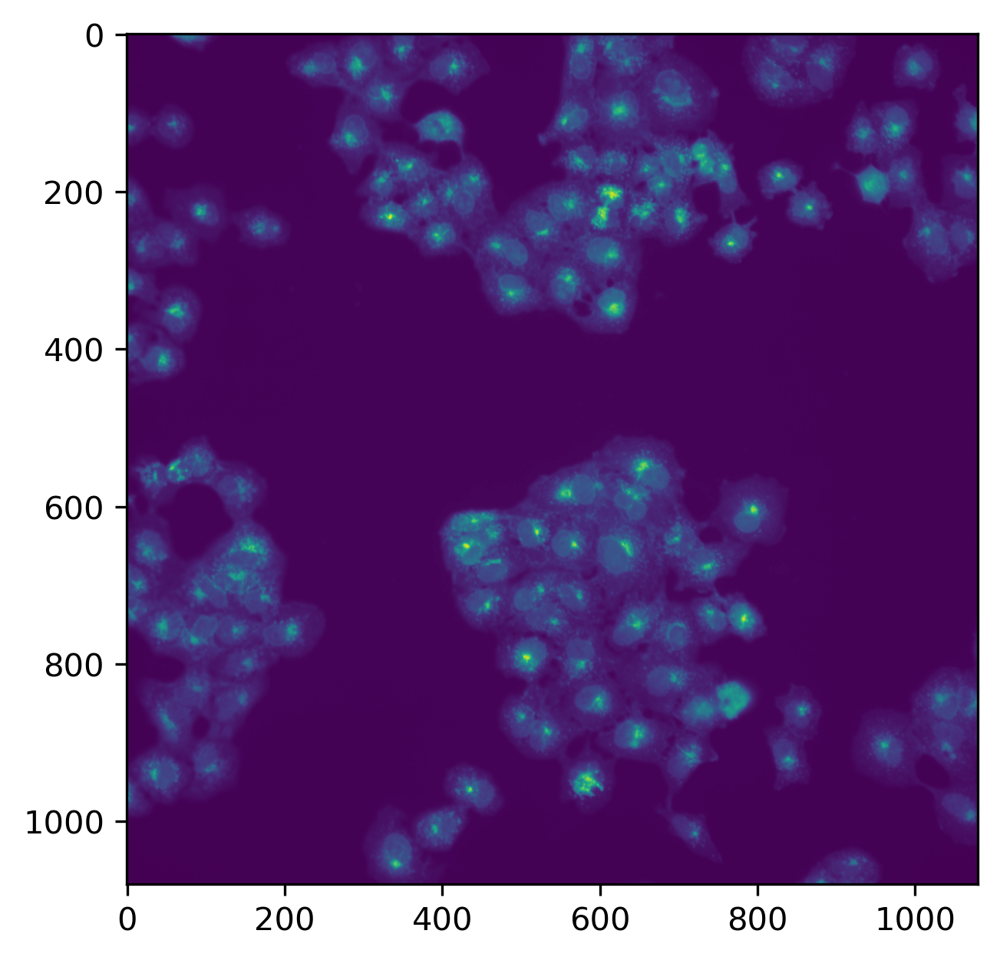

In [13]:
#@markdown ###Step 5: Read and Load all the images
#@markdown #####A random image will be shown as an example with each channel separated. If it is a single channel image, only the one channel will be shown
#imgs = [imread(f) for f in files]

imgs=[] #store all images
#Read images
for f in files:
  im=skimage.io.imread(f)
  n_dim=len(im.shape) #shape of image
  dim=im.shape #dimensions of image
  channel=min(dim) #channel will be dimension with min value usually
  channel_position=dim.index(channel)
  #if no of dim is 3 and channel is first index, swap channel to last index
  if n_dim==3 and channel_position==0:
    #print(dim)
    im=im.transpose(1,2,0)
    dim=im.shape
    #print("Shape changed")
  #print(dim)
  imgs.append(im)

nimg = len(imgs)
print("No of images loaded are: ", nimg)

print("Example Image:")

random_idx = random.choice(range(len(imgs)))
x=imgs[random_idx]
n_dim=len(x.shape)
file_name=os.path.basename(files[random_idx])
print(file_name+" has "+str(n_dim)+" dimensions/s")
if n_dim==3:
  channel_image=x.shape[2]
  fig, axs = plt.subplots(1, channel_image,figsize=(12,5))
  print("Image: %s" %(file_name))
  print("Image number: ",random_idx+1)
  for channel in range(channel_image):
      axs[channel].imshow(x[:,:,channel])
      axs[channel].set_title('Channel '+str(channel+1),size=15)
      axs[channel].axis('off')
  fig.tight_layout()
elif n_dim==2:
  print("One Channel")
  plt.imshow(x)
else:
  print("Channel number invalid or dimensions wrong. Image shape is: "+str(x.shape))



---


# **Define and Test Cellpose parameters for segmentaiton**



#### In section, we define:

*   Channels for segmentation
*   Cellpose Parameters:
    * Diameter
    * Flow Threshold
    * Cell Probability Threshold

More info on Models: https://cellpose.readthedocs.io/en/latest/models.html

#### As a general rule of thumb, segmentation of a cell using a membrane/cytoplasm dye is more accurate when used in combination with a nuclei marker.


In [14]:
#@markdown #### **STEP 6**.  RUN THIS CELL to CHOOSE a cellpose model. Select the model you want from the dropdown list.
import ipywidgets as widgets
from IPython.display import display

model_choices = widgets.Dropdown(
    options=model_list,
    value='cyto2',
    description='Model Choice:',
    disabled=False,
)

def on_change(model_change):
  print("Model changed to :",model_change.new)
print("Choose MODEL from this list before proceeeding. Default is cyto2:")
model_choices.observe(on_change,names = 'value')

display(model_choices)



Choose MODEL from this list before proceeeding. Default is cyto2:


Dropdown(description='Model Choice:', index=4, options=('cyto', 'nuclei', 'tissuenet', 'livecell', 'cyto2', 'g…

In [15]:
#@markdown #### **STEP 7**.  Define the channels to use for segmentation

model_type= model_choices.value
print("Using model ",model_type)

#@markdown If the image has only one channel, leave it segmentation channel as 0
Channel_for_segmentation="1" #@param[0,1,2,3,4,5]
segment_channel=int(Channel_for_segmentation)

# @markdown ###If you choose cytoplasm, tick if you have a nuclear channel
Use_nuclear_channel= True #@param {type:"boolean"}
Nuclear_channel="3" #@param[1,2,3,4,5]
nuclear_channel=int(Nuclear_channel)

# @markdown ###If cells are elongated or have branches, tick this. It will use omnipose

#disabling omnipose for now as the flag has been removed from CELLPOSE
#omni= False #@param {type:"boolean"}


#@markdown ### Diameter of cell (pixels):
#@markdown #### Enter 0 if you don't know and cellpose will estimate it automatically. You can define this later as well.
Diameter =  0#@param {type:"number"}
diameter=Diameter

# define CHANNELS to run segementation on
# grayscale=0, R=1, G=2, B=3
# channels = [cytoplasm, nucleus]
# if NUCLEUS channel does not exist, set the second channel to 0
# channels = [0,0]
# IF ALL YOUR IMAGES ARE THE SAME TYPE, you can give a list with 2 elements
# channels = [0,0] # IF YOU HAVE GRAYSCALE
# channels = [2,3] # IF YOU HAVE G=cytoplasm and B=nucleus
# channels = [2,1] # IF YOU HAVE G=cytoplasm and R=nucleus


#if model_choice=="Cytoplasm":
#  model_type="cyto"

##elif model_choice=="Cytoplasm2":
##  model_type="cyto2"

#elif model_choice=="Cytoplasm2_Omnipose":
#  model_type="cyto2_omni"

#elif model_choice=="Bacteria_Omnipose":
#  model_type="bact_omni"
#  diameter = 0

#elif model_choice=="Nuclei":
#  model_type="nuclei"


# channels = [cytoplasm, nucleus]
if model_type != "nuclei":
  if Use_nuclear_channel:
    channels=[segment_channel,nuclear_channel]
  else:
    channels=[segment_channel,0]
else: #nucleus
  channels=[segment_channel,0]




# DEFINE CELLPOSE MODEL
# model_type='cyto' or model_type='nuclei'
model = models.CellposeModel(gpu=use_GPU, model_type=model_type, net_avg = True)#, omni = omni

# define CHANNELS to run segementation on
# grayscale=0, R=1, G=2, B=3
# channels = [cytoplasm, nucleus]
# if NUCLEUS channel does not exist, set the second channel to 0
# channels = [0,0]
# IF ALL YOUR IMAGES ARE THE SAME TYPE, you can give a list with 2 elements
# channels = [0,0] # IF YOU HAVE GRAYSCALE
# channels = [2,3] # IF YOU HAVE G=cytoplasm and B=nucleus
# channels = [2,1] # IF YOU HAVE G=cytoplasm and R=nucleus

# or if you have different types of channels in each image
#channels = [[2,3], [0,0], [0,0]]

# if diameter is set to None, the size of the cells is estimated on a per image basis
# you can set the average cell `diameter` in pixels yourself (recommended)
# diameter can be a list or a single number for all images
if diameter == 0:
  diameter = None
  print("Diameter is set to None. The size of the cells will be estimated on a per image basis")

Using model  cyto2
2024-10-20 22:47:37,768 [INFO] >> cyto2 << model set to be used
2024-10-20 22:47:37,769 [INFO] Downloading: "https://www.cellpose.org/models/cyto2torch_0" to C:\Users\xsy\.cellpose\models\cyto2torch_0



100%|██████████| 25.3M/25.3M [00:01<00:00, 16.5MB/s]

2024-10-20 22:47:39,604 [INFO] Downloading: "https://www.cellpose.org/models/cyto2torch_1" to C:\Users\xsy\.cellpose\models\cyto2torch_1




100%|██████████| 25.3M/25.3M [00:01<00:00, 18.1MB/s]


2024-10-20 22:47:41,153 [INFO] Downloading: "https://www.cellpose.org/models/cyto2torch_2" to C:\Users\xsy\.cellpose\models\cyto2torch_2



100%|██████████| 25.3M/25.3M [00:01<00:00, 16.4MB/s]

2024-10-20 22:47:42,883 [INFO] Downloading: "https://www.cellpose.org/models/cyto2torch_3" to C:\Users\xsy\.cellpose\models\cyto2torch_3




100%|██████████| 25.3M/25.3M [00:01<00:00, 25.1MB/s]

2024-10-20 22:47:44,037 [INFO] >>>> using CPU


2024-10-20 22:47:44,182 [INFO] >>>> model diam_mean =  30.000 (ROIs rescaled to this size during training)
Diameter is set to None. The size of the cells will be estimated on a per image basis


c:\Users\xsy\anaconda3\Lib\site-packages\cellpose\resnet_torch.py:235: FutureWarning: You are using `torch.load` with `weights_only=False` (the current default value), which uses the default pickle module implicitly. It is possible to construct malicious pickle data which will execute arbitrary code during unpickling (See https://github.com/pytorch/pytorch/blob/main/SECURITY.md#untrusted-models for more details). In a future release, the default value for `weights_only` will be flipped to `True`. This limits the functions that could be executed during unpickling. Arbitrary objects will no longer be allowed to be loaded via this mode unless they are explicitly allowlisted by the user via `torch.serialization.add_safe_globals`. We recommend you start setting `weights_only=True` for any use case where you don't have full control of the loaded file. Please open an issue on GitHub for any issues related to this experimental feature.
  state_dict = torch.load(filename, map_location=torch.dev

####**Step 7.1: Test cellpose on an image. You can tune the parameters below based on your image**

The cell below gives you an opportunity to test different parameters and figure out the right combination that gives your output of interest

The ***Flow_threshold parameter*** is  the  maximum  allowed  error  of  the  flows  for  each  mask.   The  default  is 0.4.

*   **Increase** this threshold if cellpose is not returning as many masks as you’d expect

*   **Decrease** this threshold if cellpose is returning too many ill-shaped masks.

The ***Cell Probability Threshold*** determines proability that a detected object is a cell.   The  default  is 0.0.

*   **Decrease** this threshold if cellpose is not returning as many masks as you’d expect or if masks are too small

*   **Increase** this threshold if cellpose is returning too many masks esp from dull/dim areas.

If you do not know **diameter** of the cells OR if cells are of varying diameters, enter 0 in the Diameter box and cellpose will automatically estimate the diameter

For more information on the parameters: https://cellpose.readthedocs.io/_/downloads/en/latest/pdf/

Image: r01c01f02_median_aggregated


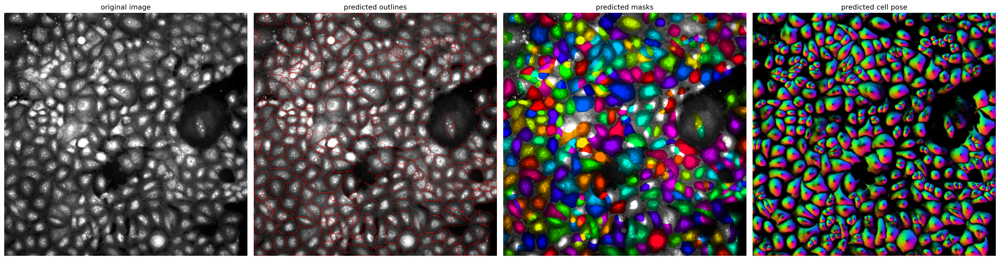

In [16]:
from skimage.util import img_as_ubyte

Image_Number =  2#@param {type:"number"}
Image_Number-=1 #indexing starts at zero
#print(Image_Number)
Diameter = 0#@param {type:"number"}
#Flow_Threshold=0.4#@param {type:"number"}
Flow_Threshold = 0.6 #@param {type:"slider", min:0.1, max:1.1, step:0.1}
flow_threshold=Flow_Threshold

#Cell_Probability_Threshold=-5#@param {type:"number"}
#Using slider to restrict values
Cell_Probability_Threshold=-5 #@param {type:"slider", min:-6, max:6, step:1}
cellprob_threshold=Cell_Probability_Threshold


diameter=Diameter
if diameter == 0:
  diameter = None
if Image_Number == -1:
  Image_Number=0
  #print("Image_Number is set to zero, opening first image.")
try:
    image = imgs[Image_Number]
except IndexError as i:
   print("Image number does not exist",i)
   print("Actual no of images in folder: ",len(imgs))
print("Image: %s" %(os.path.splitext(os.path.basename(files[Image_Number]))[0]))
img1=imgs[Image_Number]

import cv2

masks, flows, styles = model.eval(img1, diameter=diameter, flow_threshold=flow_threshold,cellprob_threshold=cellprob_threshold, channels=channels)
#masks, flows, styles, diams = model.eval(img1, diameter=diameter, flow_threshold=flow_threshold,cellprob_threshold=cellprob_threshold, channels=channels)



# DISPLAY RESULTS
from cellpose import plot
maski = masks
flowi = flows[0]

#convert to 8-bit if not so it can display properly in the graph
if img1.dtype!='uint8':
  img1=img_as_ubyte(img1)

fig = plt.figure(figsize=(24,8))
#if len(img1.shape)==3:
  #img_ch_plot = img1[:,:,segment_channel]img_ch_plot
plot.show_segmentation(fig, img1 , maski, flowi, channels=channels)
plt.tight_layout()
plt.show()



---


## **USE CELLPOSE TO SEGMENT CELLS**
The values defined above will be used for segmentation.

The masks will be saved automatically.

Saving the flow image/s are optional. Tick if you want to save them.



In [ ]:
#@markdown ### **Step 8. Run Cellpose on folder of images**

#@markdown ###Tick if you want to save the flow image/s:
Save_Flow= True #@param {type:"boolean"}
#@markdown ##### *Flow image will be resized when saved
save_flow=Save_Flow

print("Running segmentation on channel %s" %(segment_channel))
print("Using the model: ",model_type)
if diameter is None:
  print("Diameter will be estimated from the image/s")
else:
  print(f"Cellpose will use a diameter of {diameter}")

print(f"Using a flow threshold of: {flow_threshold} and a cell probability threshold of: {cellprob_threshold}")

#if too many images, it will lead to memory error.
#will evaluate on a per image basis
#masks, flows, styles, diams = model.eval(imgs, diameter=diameter, flow_threshold=flow_threshold,cellprob_threshold=cellprob_threshold, channels=channels)


#save images in folder with the diameter value used in cellpose
print("Segmentation Done. Saving Masks and flows now")
print("Save Directory is: ",save_dir)
if (not os.path.exists(save_dir)):
    os.mkdir(save_dir)

if save_flow:
  print("Saving Flow")
  flows_save_dir=save_dir+"flows"+os.sep
  print("Save Directory for flows is: ",flows_save_dir)
  if (not os.path.exists(flows_save_dir)):
      os.mkdir(flows_save_dir)


for img_idx, img in enumerate(imgs):
    file_name=os.path.splitext(os.path.basename(files[img_idx]))[0]
    print("\nSegmenting: ",file_name)
    #mask, flow, style, diam = model.eval(img, diameter=diameter, flow_threshold=flow_threshold,cellprob_threshold=cellprob_threshold, channels=channels)
    mask, flow, style = model.eval(img, diameter=diameter, flow_threshold=flow_threshold,cellprob_threshold=cellprob_threshold, channels=channels)
    #save images in folder with the diameter value used in cellpose
    print("Segmentation complete . Saving Masks and flows")
    i=1
    print(i)
    i=i+1
    #Output name for masks
    mask_output_name=save_dir+"MASK_"+file_name+".tif"
    #Save mask as 16-bit in case this has to be used for detecting than 255 objects
    mask=mask.astype(np.uint16)
    #Save flow as 8-bit
    skimage.io.imsave(mask_output_name,mask, check_contrast=False)
    if save_flow:
      #Output name for flows
      flow_output_name=flows_save_dir+"FLOWS_"+file_name+".tif"
      #Save as 8-bit
      flow_image=flow[0].astype(np.uint8)
      skimage.io.imsave(flow_output_name,flow_image, check_contrast=False)

#Save parameters used in Cellpose
parameters_file=save_dir+"Cellpose_parameters_used.txt"
outFile=open(parameters_file, "w")
outFile.write("CELLPOSE PARAMETERS\n")
outFile.write("Model: "+model_type+"\n")
if diameter == 0:
  diameter = "Automatically estimated by cellpose"
#outFile.write("Omni Flag: "+str(omni)+"\n")
outFile.write("Diameter: "+str(diameter)+"\n")
outFile.write("Flow Threshold: "+str(flow_threshold)+"\n")
outFile.write("Cell probability Threshold: "+str(cellprob_threshold)+"\n")
outFile.close()
print("\nSegmentation complete and files saved")


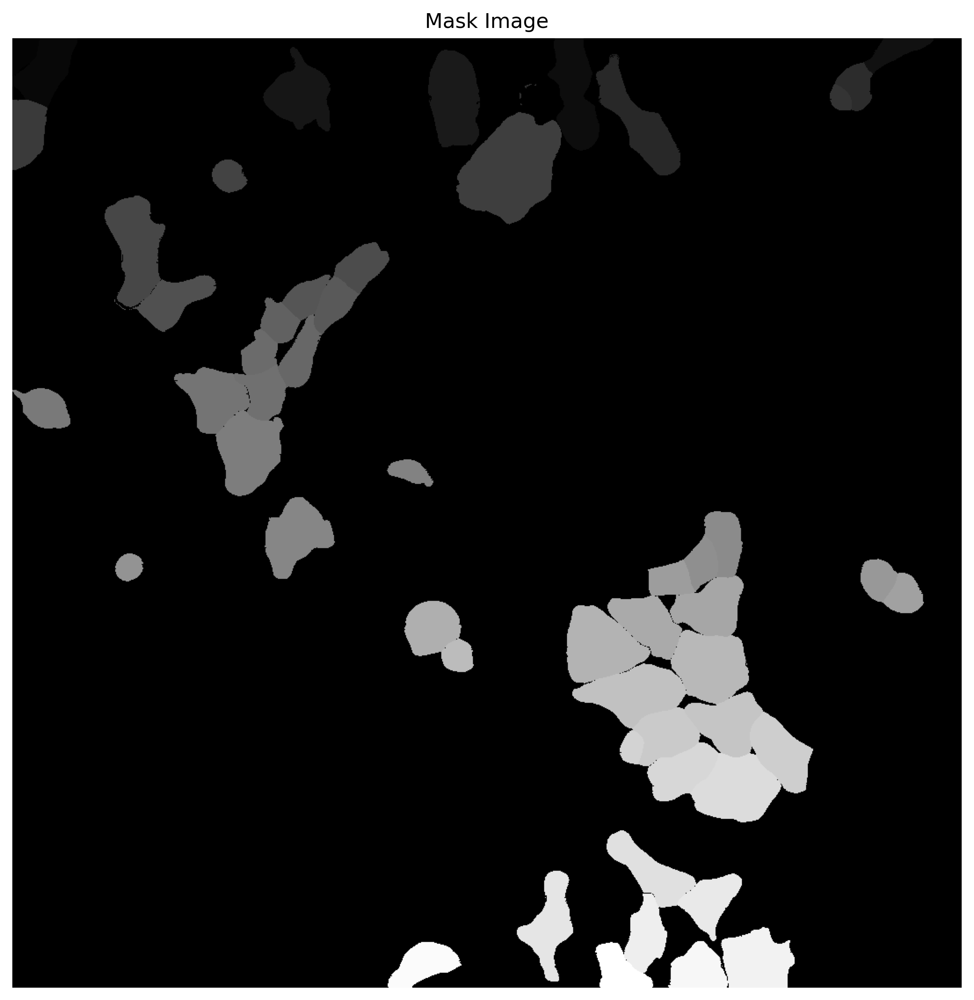

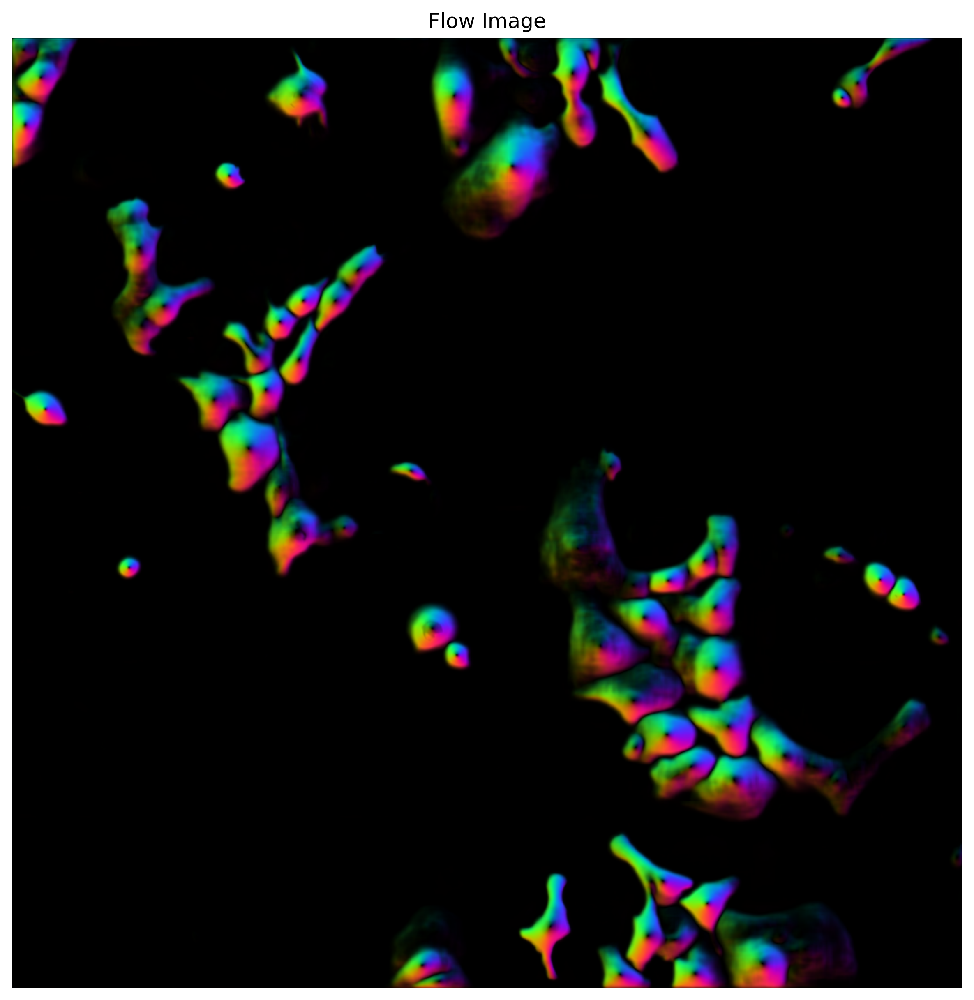

In [ ]:
import os
import pandas as pd
from skimage.io import imread
from skimage.measure import regionprops

# 设置保存掩码和流动图像的路径

mask_path = '/content/gdrive/MyDrive/example_data/Masks/MASK_r04c08f05p01-compound-FK866.tif'
flow_path = '/content/gdrive/MyDrive/example_data/Masks/flows/FLOWS_r04c08f05p01-compound-FK866.tif'


# 读取掩码和流动图像
mask = io.imread(mask_path)
flow = io.imread(flow_path)

# 可视化掩码
plt.figure(figsize=(10, 10))
plt.imshow(mask, cmap='gray')
plt.title('Mask Image')
plt.axis('off')
plt.show()

# 可视化流动图像
plt.figure(figsize=(10, 10))
plt.imshow(flow, cmap='gray')
plt.title('Flow Image')
plt.axis('off')
plt.show()


In [ ]:
import os
import pandas as pd
from skimage.io import imread
from skimage.measure import regionprops

# Set the paths for the image folder and mask folder
# image_folder = '/content/gdrive/MyDrive/example_data/'  # Path to the folder containing all images
# mask_folder = '/content/gdrive/MyDrive/example_data/Masks/'  # Path to the folder containing mask files
image_folder = 'C:/Users/xsy/Desktop/downsampled_data/'  # Path to the folder containing all images
mask_folder = 'C:/Users/xsy/Desktop/downsampled_data/Masks/'  # Path to the folder containing mask files

# Get all image filenames and mask filenames in the folders
image_files = [f for f in os.listdir(image_folder) if f.endswith('.tiff')]  # Assuming image files end with .tiff
mask_files = [f for f in os.listdir(mask_folder) if f.endswith('.tif')]  # Mask files end with .tif

# Initialize an empty list to store features from all images
all_features = []

# Function to extract the key from the filename
def extract_key(filename):
    # Assuming the key is always in the format `rxxcxxfxxpxx` and included in the filename
    parts = filename.split('_')
    key = parts[0]  # Extract the first part containing the key
    return key

def extract_key2(filename):
    # Assuming the key is always in the format `rxxcxxfxxpxx` and included in the filename
    parts = filename.split('-')
    key = parts[0]  # Extract the first part containing the key
    return key

# Loop through each image file
for image_file in image_files:
    # Extract the key from the image filename
    image_key = extract_key(image_file)

    # Find the matching mask file for the image
    matching_mask_file = None
    for mask_file in mask_files:
        if image_key in mask_file:
            matching_mask_file = mask_file
            break  # Found the matching mask file, exit the loop

    # If a matching mask file is found, read the image and mask files
    if matching_mask_file:
        image_path = os.path.join(image_folder, image_file)
        mask_path = os.path.join(mask_folder, matching_mask_file)
        mask = imread(mask_path)  # Read the mask file

        # Extract features for each cell
        props = regionprops(mask)

        for prop in props:
            feature = {
                'Image_File_Name': image_file,
                'Area': prop.area,
                'Perimeter': prop.perimeter,
                'Eccentricity': prop.eccentricity,
                'Major_Axis_Length': prop.major_axis_length,
                'Minor_Axis_Length': prop.minor_axis_length,
            }
            all_features.append(feature)
    else:
        print(f"Mask not found for {image_file}")

# Convert the features into a DataFrame
features_df = pd.DataFrame(all_features)
# grouped_features = features_df.groupby('Image_File_Name').mean()
print(features_df)
# print(grouped_features)

# Read the metadata
metadata = pd.read_csv('C:/Users/xsy/Desktop/cleaned_metadata_BR00116991.csv')

# Merge features and metadata by matching the extracted keys
features_df['Image_Key'] = features_df['Image_File_Name'].apply(extract_key)
metadata['Metadata_Key'] = metadata['FileName_OrigRNA'].apply(extract_key2)

# In features_df, create a new column where 'Image_Key' is appended with 'p01'
features_df['Image_Key_Modified'] = features_df['Image_Key'].apply(lambda x: x + 'p01')

# Merge based on the modified key
merged_data = pd.merge(features_df, metadata, left_on='Image_Key_Modified', right_on='Metadata_Key', how='inner')

# Save the merged data
merged_data.to_csv('C:/Users/xsy/Desktop/merged_data.csv', index=False)

# View the merged data
print(merged_data.head(1000))





                         Image_File_Name    Area   Perimeter  Eccentricity  \
0       r01c01f01_median_aggregated.tiff   690.0  114.461941      0.820825   
1       r01c01f01_median_aggregated.tiff  2374.0  212.894444      0.875593   
2       r01c01f01_median_aggregated.tiff  5853.0  329.320851      0.736530   
3       r01c01f01_median_aggregated.tiff  2837.0  291.338095      0.958683   
4       r01c01f01_median_aggregated.tiff   897.0  119.597980      0.775971   
...                                  ...     ...         ...           ...   
408876  r14c07f05_median_aggregated.tiff  2710.0  246.710678      0.932907   
408877  r14c07f05_median_aggregated.tiff  2030.0  181.012193      0.680916   
408878  r14c07f05_median_aggregated.tiff   895.0  118.805087      0.604023   
408879  r14c07f05_median_aggregated.tiff   542.0  104.047727      0.472574   
408880  r14c07f05_median_aggregated.tiff   482.0   90.183766      0.739080   

        Major_Axis_Length  Minor_Axis_Length  
0               

## subsample to decrease data imbalance


91316


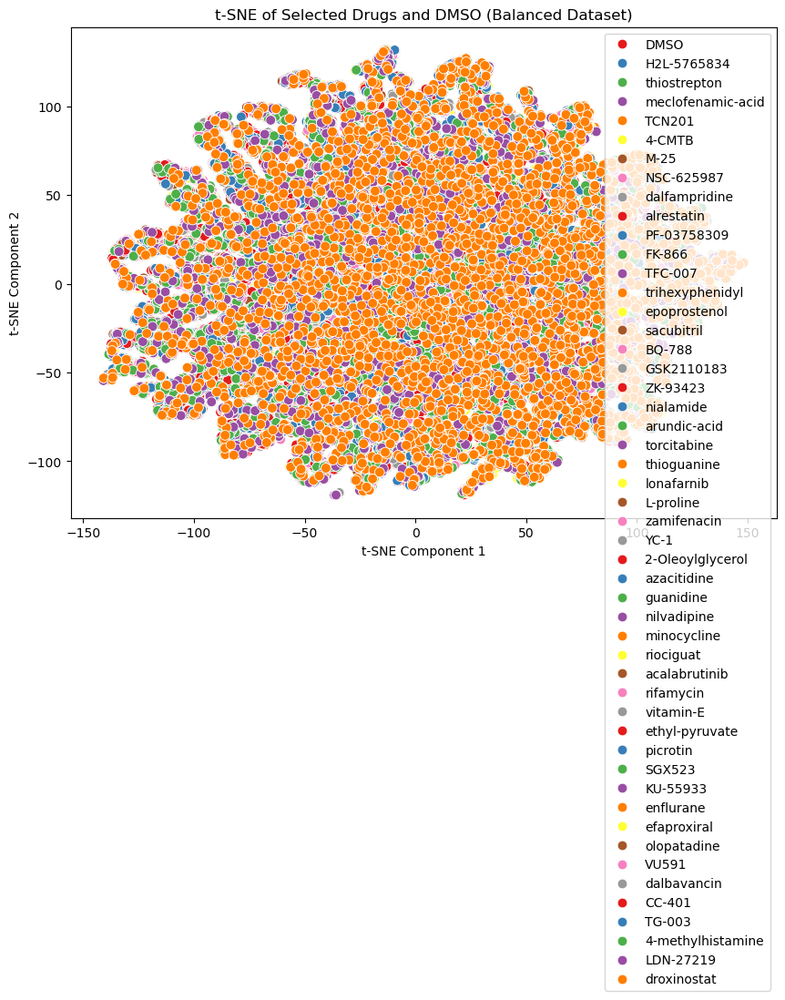

In [ ]:
import matplotlib.pyplot as plt
from sklearn.preprocessing import StandardScaler
from sklearn.manifold import TSNE
import seaborn as sns
import pandas as pd

# Select the top 500 drugs (including DMSO)
merged_data = pd.read_csv('C:/Users/xsy/Desktop/merged_data.csv')
drug_counts = merged_data['Metadata_pert_iname'].value_counts()
top_drugs = drug_counts.head(500).index  # Get the top 50 drugs
selected_drugs = top_drugs.union(['DMSO'])  # Include DMSO

# Filter the dataset to keep only DMSO and the selected drugs
filtered_data = merged_data[merged_data['Metadata_pert_iname'].isin(selected_drugs)]
dmso_data = filtered_data[filtered_data['Metadata_pert_iname'] == 'DMSO']
dmso_sample = dmso_data.sample(n=2000, random_state=42)

# Keep all data from other drug groups
non_dmso_data = filtered_data[filtered_data['Metadata_pert_iname'] != 'DMSO']

# Combine the sampled DMSO data with other drug data
balanced_data = pd.concat([dmso_sample, non_dmso_data])

# Check the length of balanced_data
print(len(balanced_data))

# Extract features and standardize them
X = balanced_data[['Area', 'Perimeter', 'Eccentricity', 'Major_Axis_Length', 'Minor_Axis_Length']]
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# Perform t-SNE dimensionality reduction
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X_scaled)

# Combine t-SNE results with drug labels
tsne_df = pd.DataFrame(X_tsne, columns=['tSNE1', 'tSNE2'])
tsne_df['Drug'] = balanced_data['Metadata_pert_iname'].values

# Visualize t-SNE results
plt.figure(figsize=(10, 7))
sns.scatterplot(x='tSNE1', y='tSNE2', hue='Drug', data=tsne_df, palette='Set1', s=60)
plt.title('t-SNE of Selected Drugs and DMSO (Balanced Dataset)')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.legend(loc='best')
plt.show()



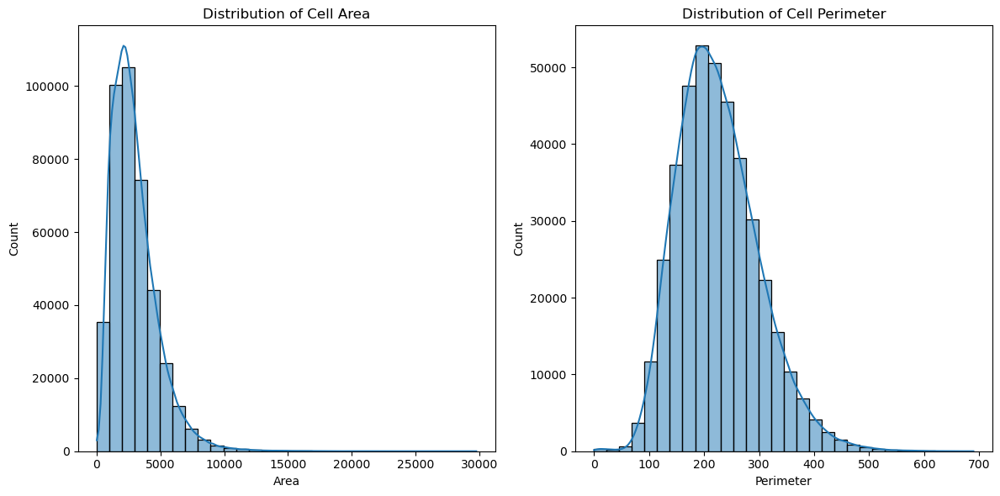

In [ ]:
import matplotlib.pyplot as plt
import seaborn as sns


plt.figure(figsize=(12, 6))


plt.subplot(1, 2, 1)
sns.histplot(merged_data['Area'], bins=30, kde=True)
plt.title('Distribution of Cell Area')
plt.xlabel('Area')


plt.subplot(1, 2, 2)
sns.histplot(merged_data['Perimeter'], bins=30, kde=True)
plt.title('Distribution of Cell Perimeter')
plt.xlabel('Perimeter')

plt.tight_layout()
plt.show()





AREA VS Perimeter

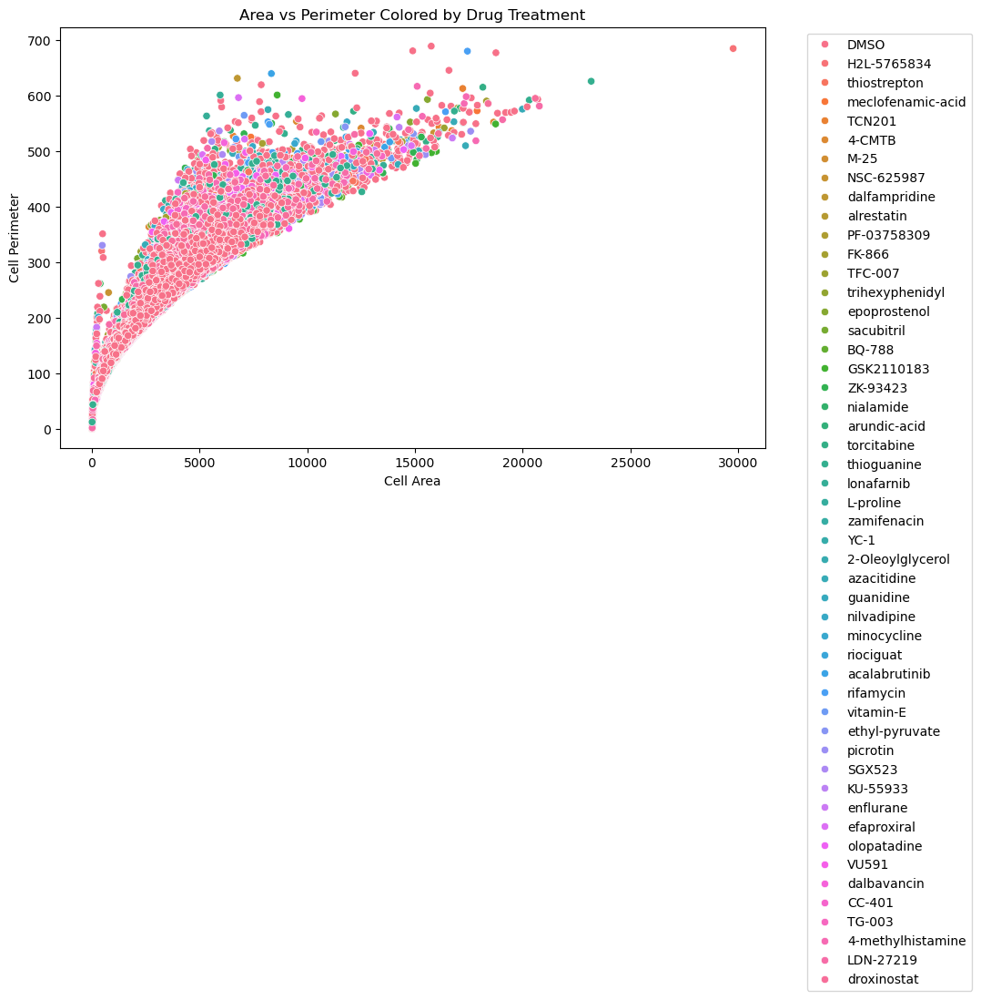

In [ ]:

plt.figure(figsize=(10, 6))
sns.scatterplot(x='Area', y='Perimeter', hue='Metadata_pert_iname', data=filtered_data)
plt.title('Area vs Perimeter Colored by Drug Treatment')
plt.xlabel('Cell Area')
plt.ylabel('Cell Perimeter')
plt.legend(bbox_to_anchor=(1.05, 1), loc='upper left')  
plt.show()


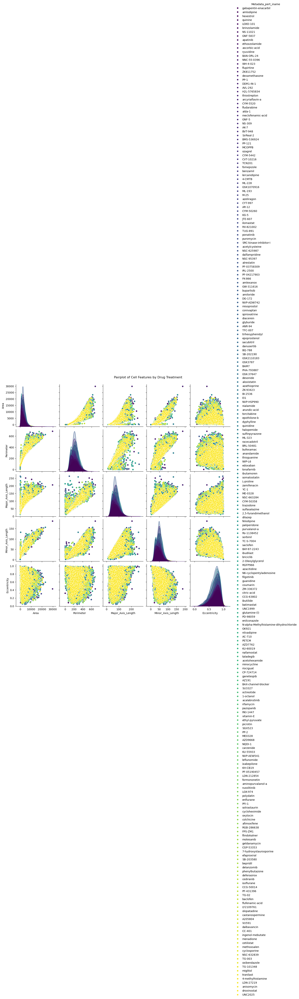

In [ ]:
features = ['Area', 'Perimeter', 'Major_Axis_Length', 'Minor_Axis_Length', 'Eccentricity']


sns.pairplot(filtered_data, vars=features, hue='Metadata_pert_iname', palette='viridis')
plt.suptitle('Pairplot of Cell Features by Drug Treatment', y=1.02)
plt.show()

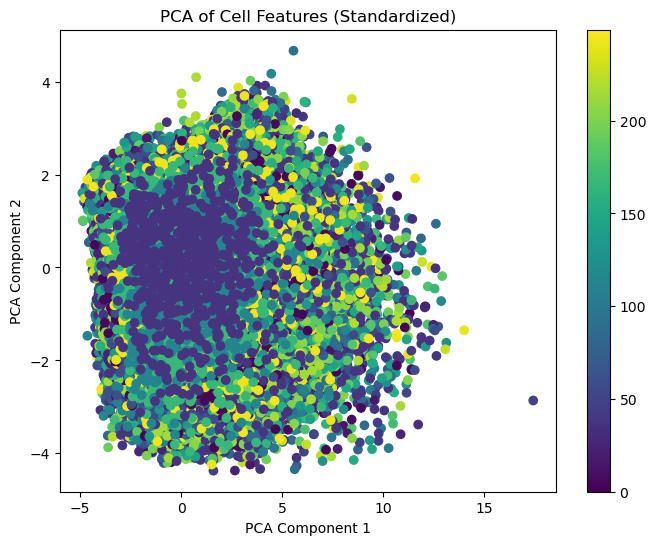

In [ ]:
from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
import matplotlib.pyplot as plt

# Extract features and Scale
X = merged_data[['Area', 'Perimeter', 'Eccentricity', 'Major_Axis_Length', 'Minor_Axis_Length']]
scaler = StandardScaler()
X_scaled = scaler.fit_transform(X)

# PCA
pca = PCA(n_components=2)
X_pca = pca.fit_transform(X_scaled)

# Plot PCA
plt.figure(figsize=(8, 6))
plt.scatter(X_pca[:, 0], X_pca[:, 1], c=merged_data['Metadata_pert_iname'].astype('category').cat.codes, cmap='viridis')
plt.colorbar()
plt.title('PCA of Cell Features (Standardized)')
plt.xlabel('PCA Component 1')
plt.ylabel('PCA Component 2')
plt.show()


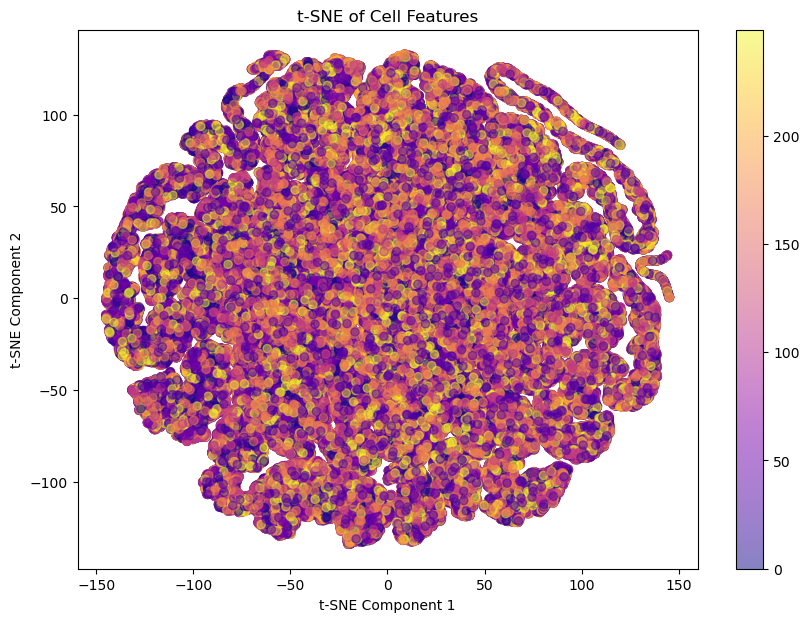

In [ ]:
from sklearn.manifold import TSNE

# use t-SNE reduce diamention
tsne = TSNE(n_components=2, random_state=42)
X_tsne = tsne.fit_transform(X)

# 
plt.figure(figsize=(10, 7))
plt.scatter(X_tsne[:, 0], X_tsne[:, 1], c=merged_data['Metadata_pert_iname'].astype('category').cat.codes, cmap='plasma', alpha=0.5)
plt.colorbar()
plt.title('t-SNE of Cell Features')
plt.xlabel('t-SNE Component 1')
plt.ylabel('t-SNE Component 2')
plt.show()


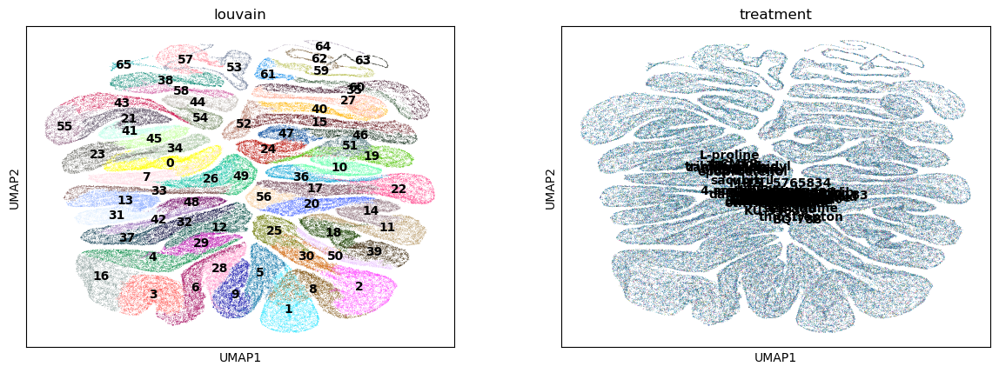

In [ ]:
!pip install scanpy
!pip install python-igraph louvain

from sklearn.preprocessing import StandardScaler
import scanpy as sc
import pandas as pd
import numpy as np

# Load the dataset
# data = pd.read_csv('/content/gdrive/MyDrive/example_data/merged_data.csv')

# Select features for clustering
features = ['Area', 'Perimeter', 'Eccentricity', 'Major_Axis_Length', 'Minor_Axis_Length']
X = filtered_data[features].values  # Extract the feature matrix

# Create an AnnData object
adata = sc.AnnData(X)

# Add metadata (e.g., drug treatment information) to AnnData
adata.obs['treatment'] = filtered_data['Metadata_pert_iname'].values

# Louvain clustering
sc.pp.neighbors(adata, n_neighbors=10)  # Construct the neighborhood graph
sc.tl.louvain(adata)  # Run Louvain clustering

# Visualize clustering results using UMAP
sc.tl.umap(adata)
# Use drug treatment as labels
sc.pl.umap(adata, color=['louvain', 'treatment'], legend_loc='on data')
plt.show()





## Random Forest Classificaion

Model Accuracy: 0.47
                   precision    recall  f1-score   support

 2-Oleoylglycerol       0.00      0.00      0.00       359
           4-CMTB       0.00      0.00      0.00       404
4-methylhistamine       0.00      0.00      0.00       435
           BQ-788       0.03      0.00      0.01       353
           CC-401       0.00      0.00      0.00       374
             DMSO       0.49      0.96      0.65     18754
           FK-866       0.02      0.00      0.00       672
       GSK2110183       0.05      0.01      0.01       552
      H2L-5765834       0.04      0.00      0.01       350
         KU-55933       0.00      0.00      0.00       366
        L-proline       0.02      0.00      0.00       406
        LDN-27219       0.00      0.00      0.00       374
             M-25       0.00      0.00      0.00       364
       NSC-625987       0.00      0.00      0.00       434
      PF-03758309       0.00      0.00      0.00       365
           SGX523       0.00      

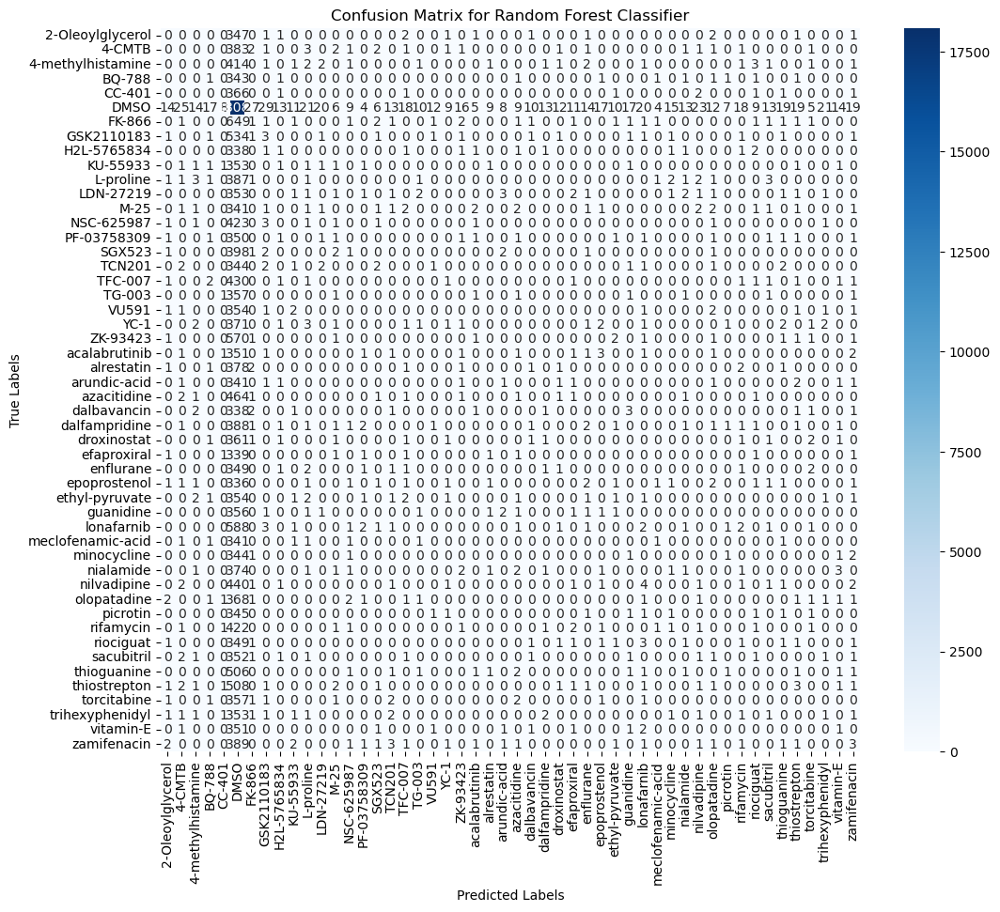

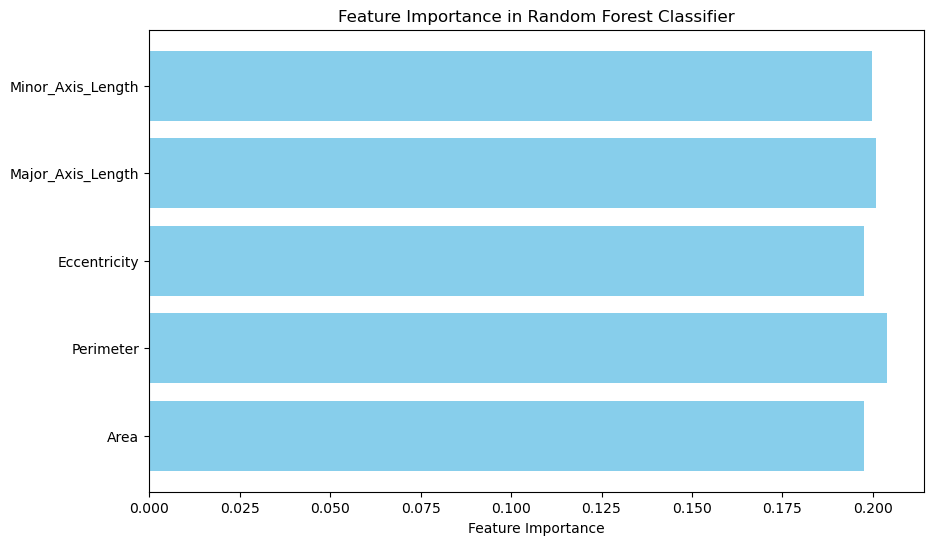

In [ ]:
import numpy as np
import pandas as pd
from sklearn.ensemble import RandomForestClassifier
from sklearn.metrics import classification_report, accuracy_score
import pandas as pd

# Display all rows
pd.set_option('display.max_rows', None)

# Set random seed
np.random.seed(521)

# Extract features and labels
X = filtered_data[['Area', 'Perimeter', 'Eccentricity', 'Major_Axis_Length', 'Minor_Axis_Length']]
y = filtered_data['Metadata_pert_iname']  # Use drug treatment names as labels

# Combine features and labels into a single DataFrame for convenience
data = pd.concat([X, y], axis=1)

# Create empty training and testing datasets
train_data = pd.DataFrame()
test_data = pd.DataFrame()

# Group by drug treatment labels and split into a 7:2 ratio
for label, group in data.groupby('Metadata_pert_iname'):
    # Calculate the number of training samples
    n_train = int(len(group) * 7 / 9)
    group = group.sample(frac=1, random_state=521)  # Shuffle the data
    train_group = group.iloc[:n_train, :]  # First 7/9 as training set
    test_group = group.iloc[n_train:, :]   # Remaining 2/9 as test set

    # Add to the training and testing datasets
    train_data = pd.concat([train_data, train_group])
    test_data = pd.concat([test_data, test_group])

# Separate features and labels
X_train = train_data.drop(columns='Metadata_pert_iname')
y_train = train_data['Metadata_pert_iname']
X_test = test_data.drop(columns='Metadata_pert_iname')
y_test = test_data['Metadata_pert_iname']

# Train a Random Forest classifier
clf = RandomForestClassifier(n_estimators=100, random_state=521)
clf.fit(X_train, y_train)

# Predict and evaluate the model
y_pred = clf.predict(X_test)

# Output the model's accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Model Accuracy: {accuracy:.2f}")

# Output detailed classification report
print(classification_report(y_test, y_pred))

import matplotlib.pyplot as plt
import seaborn as sns
from sklearn.metrics import confusion_matrix

# Generate a confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred, labels=clf.classes_)

# Plot the confusion matrix as a heatmap
plt.figure(figsize=(12, 10))
sns.heatmap(conf_matrix, annot=True, fmt='d', cmap='Blues',
            xticklabels=clf.classes_, yticklabels=clf.classes_)
plt.title('Confusion Matrix for Random Forest Classifier')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# Get feature importances
importances = clf.feature_importances_
feature_names = X_train.columns

# Plot feature importance as a bar chart
plt.figure(figsize=(10, 6))
plt.barh(feature_names, importances, color='skyblue')
plt.xlabel('Feature Importance')
plt.title('Feature Importance in Random Forest Classifier')
plt.show()




## SVM Classification

Overall Accuracy: 0.49


c:\Users\xsy\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\xsy\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\xsy\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


                   precision    recall  f1-score   support

 2-Oleoylglycerol       0.00      0.00      0.00       359
           4-CMTB       0.00      0.00      0.00       404
4-methylhistamine       0.00      0.00      0.00       435
           BQ-788       0.00      0.00      0.00       353
           CC-401       0.00      0.00      0.00       374
             DMSO       0.49      1.00      0.65     18754
           FK-866       0.00      0.00      0.00       672
       GSK2110183       0.00      0.00      0.00       552
      H2L-5765834       0.00      0.00      0.00       350
         KU-55933       0.00      0.00      0.00       366
        L-proline       0.00      0.00      0.00       406
        LDN-27219       0.00      0.00      0.00       374
             M-25       0.00      0.00      0.00       364
       NSC-625987       0.00      0.00      0.00       434
      PF-03758309       0.00      0.00      0.00       365
           SGX523       0.00      0.00      0.00       

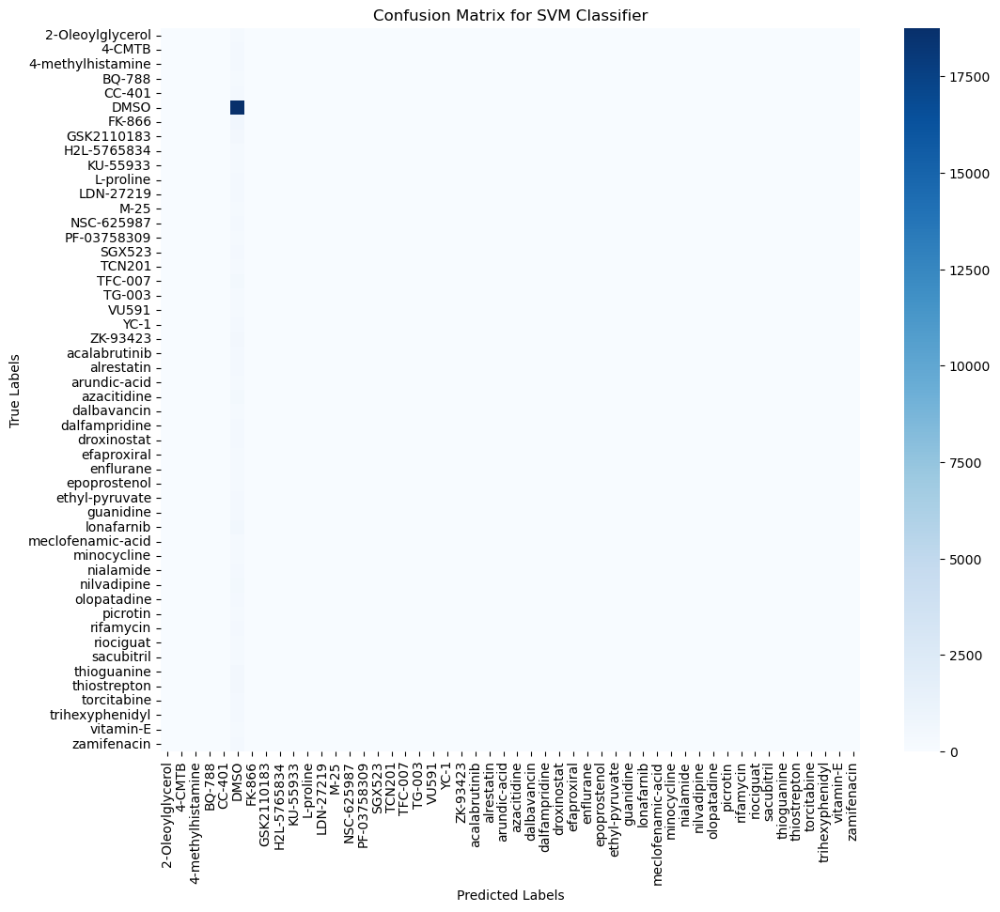

c:\Users\xsy\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\xsy\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))
c:\Users\xsy\anaconda3\Lib\site-packages\sklearn\metrics\_classification.py:1509: UndefinedMetricWarning: Precision is ill-defined and being set to 0.0 in labels with no predicted samples. Use `zero_division` parameter to control this behavior.
  _warn_prf(average, modifier, f"{metric.capitalize()} is", len(result))


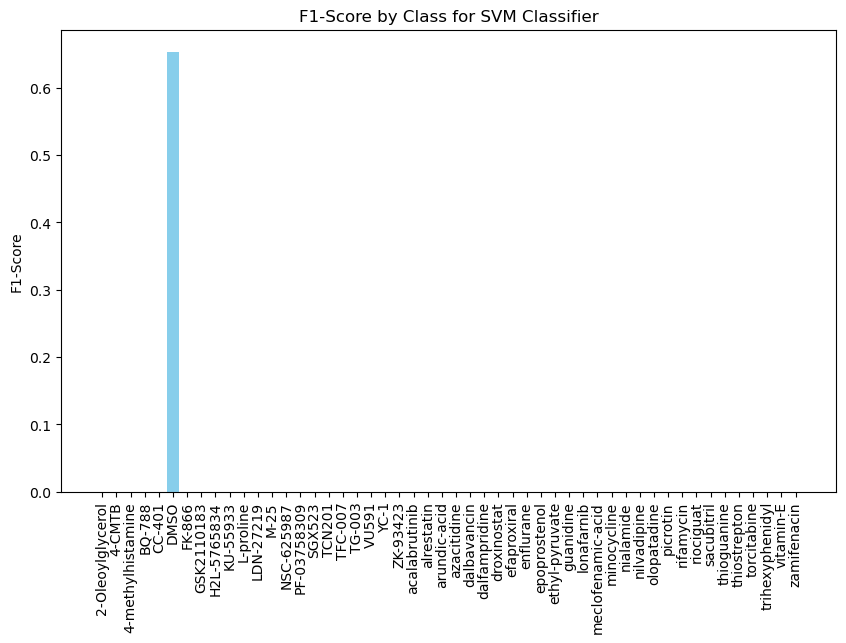

In [ ]:
import numpy as np
impimport numpy as np
import pandas as pd
from sklearn.svm import SVC
from sklearn.preprocessing import StandardScaler
from sklearn.metrics import classification_report, accuracy_score, confusion_matrix
import matplotlib.pyplot as plt
import seaborn as sns

# Set random seed
np.random.seed(521)

# Extract features and labels
X = filtered_data[['Area', 'Perimeter', 'Eccentricity', 'Major_Axis_Length', 'Minor_Axis_Length']]
y = filtered_data['Metadata_pert_iname']  # Use drug treatment names as labels

# Combine features and labels into a single DataFrame for convenience
data = pd.concat([X, y], axis=1)

# Create empty training and testing datasets
train_data = pd.DataFrame()
test_data = pd.DataFrame()

# Group by drug treatment labels and split into a 7:2 ratio
for label, group in data.groupby('Metadata_pert_iname'):
    n_train = int(len(group) * 7 / 9)  # Calculate the number of training samples
    group = group.sample(frac=1, random_state=521)  # Shuffle the data
    train_group = group.iloc[:n_train, :]  # First 7/9 as training set
    test_group = group.iloc[n_train:, :]   # Remaining 2/9 as test set
    
    # Add to the training and testing datasets
    train_data = pd.concat([train_data, train_group])
    test_data = pd.concat([test_data, test_group])

# Separate features and labels
X_train = train_data.drop(columns='Metadata_pert_iname')
y_train = train_data['Metadata_pert_iname']
X_test = test_data.drop(columns='Metadata_pert_iname')
y_test = test_data['Metadata_pert_iname']

# Standardize features
scaler = StandardScaler()
X_train_scaled = scaler.fit_transform(X_train)
X_test_scaled = scaler.transform(X_test)

# Train SVM classifier
svm_clf = SVC(kernel='linear', random_state=521)
svm_clf.fit(X_train_scaled, y_train)

# Predict and evaluate the model
y_pred = svm_clf.predict(X_test_scaled)

# Print overall accuracy
accuracy = accuracy_score(y_test, y_pred)
print(f"Overall Accuracy: {accuracy:.2f}")

# Print classification report
print(classification_report(y_test, y_pred))

# Plot confusion matrix
conf_matrix = confusion_matrix(y_test, y_pred, labels=svm_clf.classes_)
plt.figure(figsize=(12, 10))
sns.heatmap(conf_matrix, annot=False, fmt='d', cmap='Blues',
            xticklabels=svm_clf.classes_, yticklabels=svm_clf.classes_)
plt.title('Confusion Matrix for SVM Classifier')
plt.xlabel('Predicted Labels')
plt.ylabel('True Labels')
plt.show()

# Plot accuracy bar chart
report = classification_report(y_test, y_pred, output_dict=True)
accuracy_scores = [report[label]['f1-score'] for label in svm_clf.classes_]

plt.figure(figsize=(10, 6))
plt.bar(svm_clf.classes_, accuracy_scores, color='skyblue')
plt.xticks(rotation=90)
plt.ylabel('F1-Score')
plt.title('F1-Score by Class for SVM Classifier')
plt.show()



# CNN

In [ ]:
import os
import pandas as pd
import numpy as np
from skimage.io import imread
from skimage.transform import resize
import tensorflow as tf
from tensorflow.keras import layers, models
from sklearn.model_selection import train_test_split

# Set paths
merged_data_path = 'C:/Users/xsy/Desktop/merged_data.csv'
mask_folder = 'C:/Users/xsy/Desktop/downsampled_data/Masks/'

# Read the merged data
merged_data = pd.read_csv(merged_data_path)

# Extract images and labels
images = []
labels = []

# Iterate through records in merged_data.csv and load mask images
for _, row in merged_data.iterrows():
    mask_filename = 'MASK_' + row['Image_File_Name'].replace('.tiff', '.tif')  # Assume mask files end with .tif
    mask_path = os.path.join(mask_folder, mask_filename)
    
    if os.path.exists(mask_path):
        mask_image = imread(mask_path)
        mask_image = resize(mask_image, (128, 128))  # Resize to (128, 128), adjust as needed
        
        images.append(mask_image)
        labels.append(row['Metadata_pert_iname'])  # Drug treatment label

# Convert to NumPy arrays and normalize
X = np.array(images)
X = X / 255.0  # Normalize image data to [0, 1]
y = pd.factorize(labels)[0]  # Convert labels to numerical encoding

# Split into training and testing sets
X_train, X_test, y_train, y_test = train_test_split(X, y, test_size=0.2, random_state=42)

# Build the CNN model
model = models.Sequential([
    layers.Conv2D(32, (3, 3), activation='relu', input_shape=(128, 128, 1)),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(64, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Conv2D(128, (3, 3), activation='relu'),
    layers.MaxPooling2D((2, 2)),
    layers.Flatten(),
    layers.Dense(128, activation='relu'),
    layers.Dense(len(np.unique(y)), activation='softmax')  # Output layer matches the number of classes
])

# Compile the model
model.compile(optimizer='adam',
              loss='sparse_categorical_crossentropy',
              metrics=['accuracy'])

# Train the model
model.fit(X_train, y_train, epochs=10, batch_size=32, validation_split=0.1)

# Evaluate the model
test_loss, test_acc = model.evaluate(X_test, y_test)
print(f'Test accuracy: {test_acc}')